Data: https://competition.nishika.com/competitions/cable/data
 - additional_data.csv
 - additional_image.zip

In [1]:
import os

import pandas as pd
import cv2
import matplotlib.pyplot as plt

In [2]:
d = pd.read_csv('tmp/additional_data.csv')
d.shape

(1648, 3)

In [3]:
d

,filename,filename_trim,class
0,172e1676.jpg,172e1676_trim.jpg,USB_Micro_B_W
1,2ed927e9.jpg,2ed927e9_trim.jpg,USB_Mini
2,d62e1c29.jpg,d62e1c29_trim.jpg,HDMI
3,e0ccc43c.jpg,e0ccc43c_trim.jpg,VGA
4,d6a40317.jpg,d6a40317_trim.jpg,Lightning_T
...,...,...,...
1643,1a42d526.jpg,1a42d526_trim.jpg,Lightning
1644,6b3c238e.jpg,6b3c238e_trim.jpg,USB_Type_C
1645,587a4905.jpg,587a4905_trim.jpg,USB_Mini
1646,ae600959.jpg,ae600959_trim.jpg,USB_Type_C


In [4]:
d['filename_trim'].nunique()   # 画像枚数

1648

In [5]:
pd.DataFrame(d['class'].value_counts())

,class
USB_Micro_B,327
Lightning,297
USB_Type_C,257
USB_Type_A,138
HDMI,108
Lightning_T,91
DisplayPort,90
VGA,89
Mini_DisplayPort,88
USB_Mini,74


In [6]:
d['class'].nunique()

15

In [37]:
H, W, C = [], [], []
v_mean, v_min, v_max = [], [], []
im_pathes = []
for f in d['filename_trim']:
    im_path = os.path.join('tmp', 'additional', f)
    im_pathes.append(im_path)
    im = cv2.imread(im_path)
    H.append(im.shape[0])
    W.append(im.shape[1])
    C.append(im.shape[2])
    v_mean.append(im.mean())
    v_min.append(im.min()*1.0)
    v_max.append(im.max()*1.0)
df_shape = pd.DataFrame({'H':H, 'W':W, 'C':C, 'val_mean':v_mean, 'val_min':v_min, 'val_max':v_max})
df_shape.shape

(1648, 6)

In [41]:
im[0]   # 値のデータ型に注意

array([[109, 137, 101],
       [110, 138, 102],
       [112, 140, 104],
       ...,
       [120, 144, 110],
       [120, 144, 110],
       [120, 144, 110]], dtype=uint8)

In [38]:
df_shape

,H,W,C,val_mean,val_min,val_max
0,457,589,3,122.470120,0.0,255.0
1,504,526,3,82.107685,0.0,255.0
2,314,459,3,159.378176,0.0,255.0
3,493,858,3,136.101250,0.0,255.0
4,213,320,3,108.241500,0.0,255.0
...,...,...,...,...,...,...
1643,605,605,3,104.933571,0.0,255.0
1644,502,449,3,114.317016,0.0,255.0
1645,375,538,3,82.592340,0.0,255.0
1646,216,216,3,109.018140,15.0,254.0


In [39]:
df_shape.describe()

,H,W,C,val_mean,val_min,val_max
count,1648.000000,1648.000000,1648.0,1648.000000,1648.000000,1648.000000
mean,454.411408,563.636529,3.0,110.843826,3.472087,250.315534
std,204.406023,229.757689,0.0,37.393600,9.319425,14.509841
min,31.000000,69.000000,3.0,13.897487,0.000000,106.000000
25%,294.500000,409.000000,3.0,81.752360,0.000000,255.000000
50%,453.000000,563.500000,3.0,109.836705,0.000000,255.000000
75%,605.000000,625.500000,3.0,138.521007,0.000000,255.000000
max,1622.000000,1512.000000,3.0,226.803451,95.000000,255.000000


画像サイズ： (H, W, C) = ([31, 1622], [69, 1512], 3)

In [25]:
d_master = pd.concat([d, df_shape], axis=1)
d_master

,filename,filename_trim,class,H,W,C,val_mean,val_min,val_max
0,172e1676.jpg,172e1676_trim.jpg,USB_Micro_B_W,457,589,3,122.470120,0,-1
1,2ed927e9.jpg,2ed927e9_trim.jpg,USB_Mini,504,526,3,82.107685,0,-1
2,d62e1c29.jpg,d62e1c29_trim.jpg,HDMI,314,459,3,159.378176,0,-1
3,e0ccc43c.jpg,e0ccc43c_trim.jpg,VGA,493,858,3,136.101250,0,-1
4,d6a40317.jpg,d6a40317_trim.jpg,Lightning_T,213,320,3,108.241500,0,-1
...,...,...,...,...,...,...,...,...,...
1643,1a42d526.jpg,1a42d526_trim.jpg,Lightning,605,605,3,104.933571,0,-1
1644,6b3c238e.jpg,6b3c238e_trim.jpg,USB_Type_C,502,449,3,114.317016,0,-1
1645,587a4905.jpg,587a4905_trim.jpg,USB_Mini,375,538,3,82.592340,0,-1
1646,ae600959.jpg,ae600959_trim.jpg,USB_Type_C,216,216,3,109.018140,15,-2


In [27]:
im = cv2.imread(os.path.join('tmp', 'additional', '172e1676.jpg'))

In [28]:
im

array([[[180, 187, 190],
        [177, 184, 187],
        [181, 188, 191],
        ...,
        [181, 188, 197],
        [173, 182, 192],
        [172, 181, 191]],

       [[181, 188, 191],
        [178, 185, 188],
        [180, 187, 190],
        ...,
        [178, 185, 194],
        [175, 184, 194],
        [179, 188, 198]],

       [[182, 187, 190],
        [180, 185, 188],
        [180, 185, 188],
        ...,
        [175, 182, 191],
        [173, 182, 191],
        [176, 185, 194]],

       ...,

       [[209, 211, 211],
        [210, 212, 212],
        [210, 212, 212],
        ...,
        [197, 196, 198],
        [195, 197, 198],
        [195, 197, 198]],

       [[209, 211, 211],
        [209, 211, 211],
        [210, 212, 212],
        ...,
        [196, 195, 197],
        [194, 196, 197],
        [194, 196, 197]],

       [[210, 212, 212],
        [209, 211, 211],
        [210, 212, 212],
        ...,
        [194, 193, 195],
        [195, 197, 198],
        [196, 198, 199]]

In [29]:
im.max()

254

In [23]:
d_master['area'] = d_master['H'] *  d_master['W']

In [30]:
d_master.min()

filename              00037f39.jpg
filename_trim    00037f39_trim.jpg
class                  DisplayPort
H                               31
W                               69
C                                3
area                          3317
dtype: object

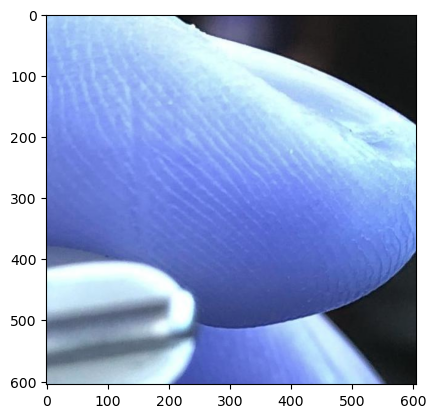

In [32]:
im = cv2.imread(os.path.join('tmp', 'additional', '00037f39_trim.jpg'))
plt.imshow(im)
plt.show()

In [25]:
d_master.max()

filename              ffd560d1.jpg
filename_trim    ffd560d1_trim.jpg
class                          VGA
H                             1622
W                             1512
C                                3
area                       2291886
dtype: object

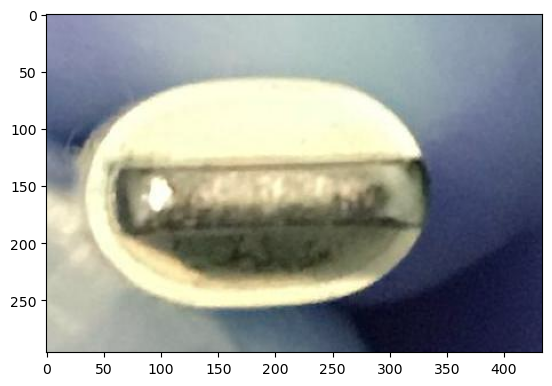

In [31]:
im = cv2.imread(os.path.join('tmp', 'additional', 'ffd560d1_trim.jpg'))
plt.imshow(im)
plt.show()

['USB_Micro_B_W', 'USB_Mini', 'HDMI', 'VGA', 'Lightning_T', 'USB_Type_C', 'Mini_DisplayPort', 'Lightning', 'RJ_45', 'USB_Micro_B', 'USB_Type_B', 'USB_Type_A', 'DisplayPort', 'Dock', 'USB_Micro_B_3.1']


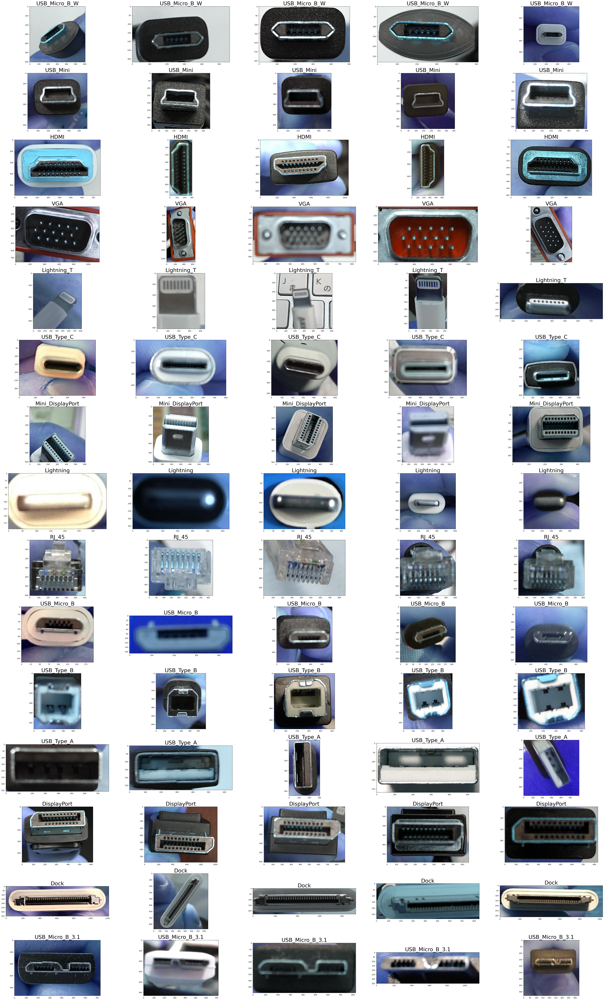

In [42]:
# ランダムにLabel別画像を表示

### ランダムサンプリング
sample_img_path = {}   # label:image_path 形式で表示データを保存
keys = d['class'].unique().tolist()
print(keys)
N = 5   # num of samples from each class

sampled_images = d.groupby('class').apply(lambda x: x.sample(n=N))   # ランダムにサンンプリング

for k in keys:
    tmp = sampled_images[sampled_images['class']==k]['filename_trim']
    sample_img_path[k] = [os.path.join('tmp', 'additional', i) for i in tmp]
#sample_img_path

### プロット
fig = plt.figure(figsize=(60, 100))
counter = 1
for k in sample_img_path.keys():
    #print(k)
    for v in sample_img_path[k]:
        #print(v)
        #print(counter)
        ax = fig.add_subplot(15, N, counter)
        ax.set_title(k, fontsize=30)
        im = cv2.imread(v)
        plt.imshow(im)
        counter = counter + 1